<a href="https://colab.research.google.com/github/unni2888/CognoRise-Infotech/blob/main/Breast_Cancer_Classification_(CognoRise_Infotech).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.ensemble import IsolationForest
from sklearn.preprocessing import MinMaxScaler, LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.feature_selection import RFE
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report, roc_curve, roc_auc_score

In [ ]:
df = pd.read_csv('data.csv')

# EDA and Visualizations

In [ ]:
df.head()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,NaN
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,NaN
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,NaN
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,NaN
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,NaN


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 33 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       569 non-null    int64  
 1   diagnosis                569 non-null    object 
 2   radius_mean              569 non-null    float64
 3   texture_mean             569 non-null    float64
 4   perimeter_mean           569 non-null    float64
 5   area_mean                569 non-null    float64
 6   smoothness_mean          569 non-null    float64
 7   compactness_mean         569 non-null    float64
 8   concavity_mean           569 non-null    float64
 9   concave points_mean      569 non-null    float64
 10  symmetry_mean            569 non-null    float64
 11  fractal_dimension_mean   569 non-null    float64
 12  radius_se                569 non-null    float64
 13  texture_se               569 non-null    float64
 14  perimeter_se             5

In [ ]:
df['Unnamed: 32']

0     NaN
1     NaN
2     NaN
3     NaN
4     NaN
       ..
564   NaN
565   NaN
566   NaN
567   NaN
568   NaN
Name: Unnamed: 32, Length: 569, dtype: float64

In [ ]:
df.drop('Unnamed: 32', axis = 1, inplace = True)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 32 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       569 non-null    int64  
 1   diagnosis                569 non-null    object 
 2   radius_mean              569 non-null    float64
 3   texture_mean             569 non-null    float64
 4   perimeter_mean           569 non-null    float64
 5   area_mean                569 non-null    float64
 6   smoothness_mean          569 non-null    float64
 7   compactness_mean         569 non-null    float64
 8   concavity_mean           569 non-null    float64
 9   concave points_mean      569 non-null    float64
 10  symmetry_mean            569 non-null    float64
 11  fractal_dimension_mean   569 non-null    float64
 12  radius_se                569 non-null    float64
 13  texture_se               569 non-null    float64
 14  perimeter_se             5

In [ ]:
df.diagnosis.value_counts()

diagnosis
B    357
M    212
Name: count, dtype: int64

In [ ]:
df[df.duplicated()]

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst


In [ ]:
df.drop('id', axis = 1, inplace = True)

In [ ]:
df.columns

Index(['diagnosis', 'radius_mean', 'texture_mean', 'perimeter_mean',
       'area_mean', 'smoothness_mean', 'compactness_mean', 'concavity_mean',
       'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean',
       'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se',
       'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se',
       'fractal_dimension_se', 'radius_worst', 'texture_worst',
       'perimeter_worst', 'area_worst', 'smoothness_worst',
       'compactness_worst', 'concavity_worst', 'concave points_worst',
       'symmetry_worst', 'fractal_dimension_worst'],
      dtype='object')

## Boxplots

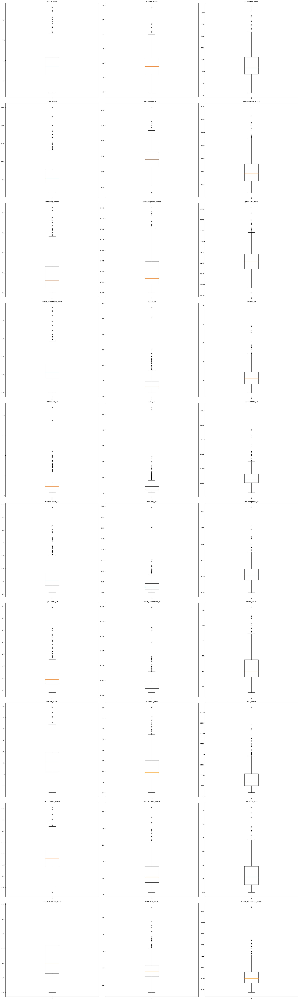

In [ ]:
# Create 5x2 subplots
fig, ax = plt.subplots(10, 3, figsize=(30, 100))

# Flatten the 2D array of axes for easier iteration
ax_flat = ax.flatten()

# List of columns to plot
columns = ['radius_mean', 'texture_mean', 'perimeter_mean', 'area_mean',
           'smoothness_mean', 'compactness_mean', 'concavity_mean', 'concave points_mean',
           'symmetry_mean', 'fractal_dimension_mean', 'radius_se', 'texture_se',
           'perimeter_se', 'area_se', 'smoothness_se', 'compactness_se',
           'concavity_se', 'concave points_se', 'symmetry_se', 'fractal_dimension_se',
           'radius_worst', 'texture_worst', 'perimeter_worst', 'area_worst',
           'smoothness_worst', 'compactness_worst', 'concavity_worst', 'concave points_worst',
           'symmetry_worst', 'fractal_dimension_worst']

# Plot each column in its respective subplot
for i, col in enumerate(columns):
    ax_flat[i].boxplot(df[col])
    ax_flat[i].set_title(col)

# Adjust layout to prevent overlap
plt.tight_layout()
plt.show()


## Count Plot

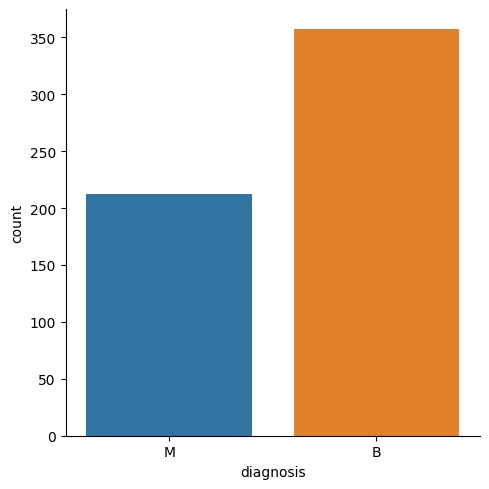

In [ ]:
sns.catplot(x = 'diagnosis',data = df, hue = 'diagnosis', kind = 'count')

## Converting the Target variable into categorical and Encoding it

In [ ]:
df['diagnosis'] = df['diagnosis'].astype('category')

In [ ]:
df['diagnosis'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 569 entries, 0 to 568
Series name: diagnosis
Non-Null Count  Dtype   
--------------  -----   
569 non-null    category
dtypes: category(1)
memory usage: 821.0 bytes


In [ ]:
df['diagnosis'].value_counts()

diagnosis
B    357
M    212
Name: count, dtype: int64

In [ ]:
df['diagnosis'] = LabelEncoder().fit_transform(df['diagnosis'])

In [ ]:
df['diagnosis'].value_counts()

diagnosis
0    357
1    212
Name: count, dtype: int64

## Outlier Handling (Isolation Forest)

In [ ]:
IsoFor = IsolationForest(contamination = 0.01)

In [ ]:
IsoFor.fit(df)

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but IsolationForest was fitted with feature names
  warnings.warn(


IsolationForest(contamination=0.01)

In [ ]:
IsoFor.predict(df)

array([ 1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1, -1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1, -1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1, -1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1, -1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1, -1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1

In [ ]:
df['Anomaly'] = IsoFor.predict(df)

In [ ]:
df.head()

,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Anomaly
0,1,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,1
1,1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,1
2,1,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,1
3,1,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,1
4,1,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,1


In [ ]:
df[df['Anomaly'] == -1]

,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Anomaly
78,1,20.180,23.97,143.70,1245.0,0.1286,0.3454,0.3754,0.16040,0.2906,...,31.72,170.30,1623.0,0.1639,0.6164,0.7681,0.2508,0.5440,0.09964,-1
108,1,22.270,19.67,152.80,1509.0,0.1326,0.2768,0.4264,0.18230,0.2556,...,28.01,206.80,2360.0,0.1701,0.6997,0.9608,0.2910,0.4055,0.09789,-1
122,1,24.250,20.20,166.20,1761.0,0.1447,0.2867,0.4268,0.20120,0.2655,...,23.99,180.90,2073.0,0.1696,0.4244,0.5803,0.2248,0.3222,0.08009,-1
152,0,9.731,15.34,63.78,300.2,0.1072,0.1599,0.4108,0.07857,0.2548,...,19.49,71.04,380.5,0.1292,0.2772,0.8216,0.1571,0.3108,0.12590,-1
212,1,28.110,18.47,188.50,2499.0,0.1142,0.1516,0.3201,0.15950,0.1648,...,18.47,188.50,2499.0,0.1142,0.1516,0.3201,0.1595,0.1648,0.05525,-1
461,1,27.420,26.27,186.90,2501.0,0.1084,0.1988,0.3635,0.16890,0.2061,...,31.37,251.20,4254.0,0.1357,0.4256,0.6833,0.2625,0.2641,0.07427,-1


## Deleting Outliers

In [ ]:
df.drop(df[df['Anomaly'] == -1].index, axis = 0, inplace = True )

In [ ]:
df[df['Anomaly'] == -1]

,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Anomaly


## Pair Plot

In [ ]:
sns.pairplot(df, hue = 'diagnosis')

## Normalizing the DataFrame

In [ ]:
df.drop('Anomaly', axis = 1, inplace = True)

In [ ]:
df = MinMaxScaler().fit_transform(df)

In [ ]:
df

array([[1.        , 0.5439498 , 0.0226581 , ..., 0.91422666, 0.59846245,
        0.41886396],
       [1.        , 0.67142645, 0.27257355, ..., 0.6407165 , 0.23358959,
        0.22287813],
       [1.        , 0.62794604, 0.3902604 , ..., 0.83706511, 0.40370589,
        0.21343303],
       ...,
       [1.        , 0.47527052, 0.62123774, ..., 0.48846021, 0.12872068,
        0.1519087 ],
       [1.        , 0.67290874, 0.66351031, ..., 0.91284878, 0.49714173,
        0.45231536],
       [0.        , 0.03849004, 0.50152181, ..., 0.        , 0.25744136,
        0.10068215]])

In [ ]:
df = pd.DataFrame(df, columns = ['diagnosis', 'radius_mean', 'texture_mean', 'perimeter_mean',
       'area_mean', 'smoothness_mean', 'compactness_mean', 'concavity_mean',
       'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean',
       'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se',
       'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se',
       'fractal_dimension_se', 'radius_worst', 'texture_worst',
       'perimeter_worst', 'area_worst', 'smoothness_worst',
       'compactness_worst', 'concavity_worst', 'concave points_worst',
       'symmetry_worst', 'fractal_dimension_worst'],)

In [ ]:
df.head()

,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,1.0,0.543950,0.022658,0.571253,0.407073,0.593753,0.884255,0.851831,0.768949,0.686364,...,0.692460,0.141525,0.750126,0.564802,0.601136,0.619292,0.568610,0.914227,0.598462,0.418864
1,1.0,0.671426,0.272574,0.644277,0.561358,0.289880,0.202931,0.246665,0.366806,0.379798,...,0.676984,0.303571,0.605903,0.545399,0.347553,0.154563,0.192971,0.640717,0.233590,0.222878
2,1.0,0.627946,0.390260,0.623310,0.502967,0.514309,0.481200,0.560318,0.668583,0.509596,...,0.620635,0.360075,0.570686,0.469324,0.483590,0.385375,0.359744,0.837065,0.403706,0.213433
3,1.0,0.219329,0.360839,0.244306,0.115167,0.811321,0.905828,0.685211,0.549922,0.776263,...,0.276984,0.385928,0.270893,0.117808,0.915472,0.814012,0.548642,0.887013,1.000000,0.773711
4,1.0,0.657592,0.156578,0.660184,0.547591,0.430351,0.388398,0.562021,0.545217,0.378283,...,0.579762,0.123934,0.569009,0.428052,0.437364,0.172415,0.319489,0.559766,0.157500,0.142595


## Splitting into X and y

In [ ]:
X = df.drop('diagnosis', axis = 1)
y = df['diagnosis']

# Train-Test Split

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 42)

# Model Building

## Logistic Regression with all variables

In [ ]:
LogReg_model = LogisticRegression()
LogReg_model.fit(X_train, y_train)

LogisticRegression()

In [ ]:
accuracy_score(y_train, LogReg_model.predict(X_train))

0.9733333333333334

In [ ]:
confusion_matrix(y_train, LogReg_model.predict(X_train))

array([[288,   1],
       [ 11, 150]])

In [ ]:
print(classification_report(y_train, LogReg_model.predict(X_train)))

              precision    recall  f1-score   support

         0.0       0.96      1.00      0.98       289
         1.0       0.99      0.93      0.96       161

    accuracy                           0.97       450
   macro avg       0.98      0.96      0.97       450
weighted avg       0.97      0.97      0.97       450



Text(0, 0.5, 'True Positive Rate')

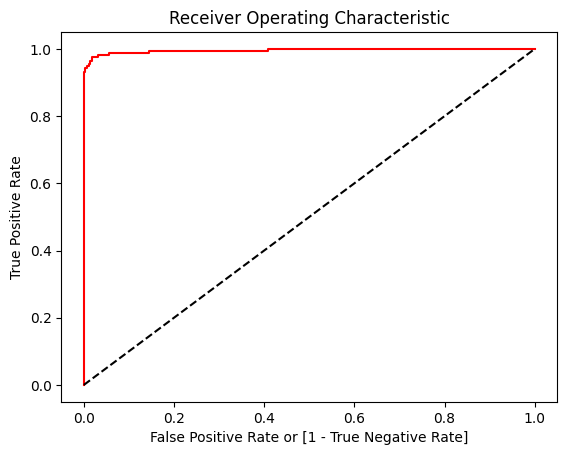

In [ ]:
fpr, tpr, thresholds = roc_curve(y_train, LogReg_model.predict_proba(X_train)[:,1])

auc = roc_auc_score(y_train, LogReg_model.predict(X_train))

plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, color='red', label='logit model ( area  = %0.2f)'%auc)
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate or [1 - True Negative Rate]')
plt.ylabel('True Positive Rate')

### Metrics for Test Data (Logistic Regression)

In [ ]:
accuracy_score(y_test, LogReg_model.predict(X_test))

0.9380530973451328

In [ ]:
confusion_matrix(y_test, LogReg_model.predict(X_test))

array([[67,  0],
       [ 7, 39]])

In [ ]:
print(classification_report(y_test, LogReg_model.predict(X_test)))

              precision    recall  f1-score   support

         0.0       0.91      1.00      0.95        67
         1.0       1.00      0.85      0.92        46

    accuracy                           0.94       113
   macro avg       0.95      0.92      0.93       113
weighted avg       0.94      0.94      0.94       113



Text(0, 0.5, 'True Positive Rate')

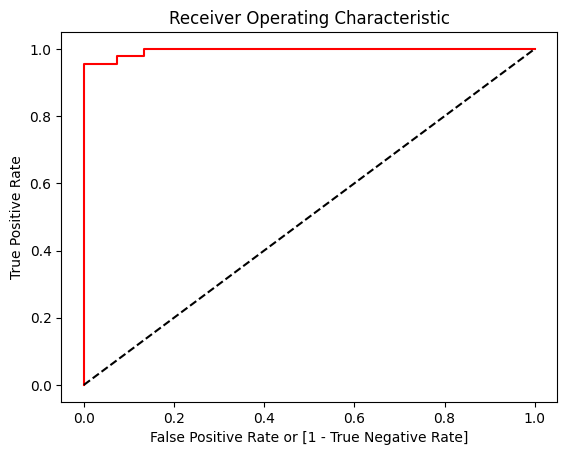

In [ ]:
fpr, tpr, thresholds = roc_curve(y_test, LogReg_model.predict_proba(X_test)[:,1])

auc = roc_auc_score(y_test, LogReg_model.predict(X_test))

plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, color='red', label='logit model ( area  = %0.2f)'%auc)
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate or [1 - True Negative Rate]')
plt.ylabel('True Positive Rate')

# Feature Selection (Recursive Feature Elimination(RFE))

In [ ]:
rfe_fit = RFE(estimator = LogisticRegression(), n_features_to_select = 10).fit(X_train, y_train)

In [ ]:
rfe_fit.support_

array([False, False,  True, False, False, False, False,  True, False,
       False,  True, False, False, False, False, False, False, False,
       False, False,  True,  True,  True,  True, False, False,  True,
        True,  True, False])

In [ ]:
rfe_fit.ranking_

array([ 2,  4,  1,  5, 13, 18,  6,  1, 12, 14,  1, 20,  8,  7, 17, 11, 19,
       21, 15,  9,  1,  1,  1,  1,  3, 10,  1,  1,  1, 16])

In [ ]:
rfe_dict = dict(zip(X.columns, rfe_fit.ranking_))
rfe_dict = sorted(rfe_dict.items(), key = lambda x: x[1])
rfe_dict = pd.DataFrame(rfe_dict, columns = ['Feature', 'Ranking'])

In [ ]:
rfe_dict

,Feature,Ranking
0,perimeter_mean,1
1,concave points_mean,1
2,radius_se,1
3,radius_worst,1
4,texture_worst,1
5,perimeter_worst,1
6,area_worst,1
7,concavity_worst,1
8,concave points_worst,1
9,symmetry_worst,1


In [ ]:
rfe_dict = rfe_dict.iloc[:10,:]
rfe_dict

,Feature,Ranking
0,perimeter_mean,1
1,concave points_mean,1
2,radius_se,1
3,radius_worst,1
4,texture_worst,1
5,perimeter_worst,1
6,area_worst,1
7,concavity_worst,1
8,concave points_worst,1
9,symmetry_worst,1


## Logistic Regression with Selected Features

In [ ]:
LogReg_model_2 = LogisticRegression()
LogReg_model_2.fit(X_train[rfe_dict['Feature']], y_train)

LogisticRegression()

In [ ]:
accuracy_score(y_train, LogReg_model_2.predict(X_train[rfe_dict['Feature']]))

0.9688888888888889

In [ ]:
confusion_matrix(y_train, LogReg_model_2.predict(X_train[rfe_dict['Feature']]))

array([[288,   1],
       [ 13, 148]])

In [ ]:
print(classification_report(y_train, LogReg_model_2.predict(X_train[rfe_dict['Feature']])))

              precision    recall  f1-score   support

         0.0       0.96      1.00      0.98       289
         1.0       0.99      0.92      0.95       161

    accuracy                           0.97       450
   macro avg       0.98      0.96      0.97       450
weighted avg       0.97      0.97      0.97       450



Text(0, 0.5, 'True Positive Rate')

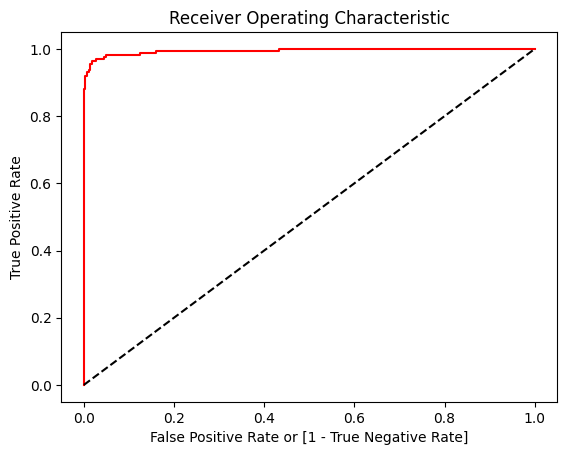

In [ ]:
fpr, tpr, thresholds = roc_curve(y_train, LogReg_model_2.predict_proba(X_train[rfe_dict['Feature']])[:,1])

auc = roc_auc_score(y_train, LogReg_model_2.predict(X_train[rfe_dict['Feature']]))

plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, color='red', label='logit model ( area  = %0.2f)'%auc)
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate or [1 - True Negative Rate]')
plt.ylabel('True Positive Rate')

### Metrics for Test Data (Logistic Regression with Selected Features)

In [ ]:
accuracy_score(y_test, LogReg_model_2.predict(X_test[rfe_dict['Feature']]))

0.9469026548672567

In [ ]:
confusion_matrix(y_test, LogReg_model_2.predict(X_test[rfe_dict['Feature']]))

array([[67,  0],
       [ 6, 40]])

In [ ]:
print(classification_report(y_test, LogReg_model_2.predict(X_test[rfe_dict['Feature']])))

              precision    recall  f1-score   support

         0.0       0.92      1.00      0.96        67
         1.0       1.00      0.87      0.93        46

    accuracy                           0.95       113
   macro avg       0.96      0.93      0.94       113
weighted avg       0.95      0.95      0.95       113



Text(0, 0.5, 'True Positive Rate')

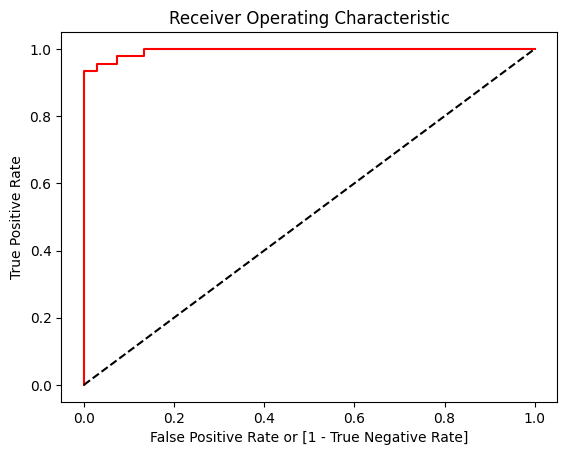

In [ ]:
fpr, tpr, thresholds = roc_curve(y_test, LogReg_model_2.predict_proba(X_test[rfe_dict['Feature']])[:,1])

auc = roc_auc_score(y_test, LogReg_model_2.predict(X_test[rfe_dict['Feature']]))

plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, color='red', label='logit model ( area  = %0.2f)'%auc)
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate or [1 - True Negative Rate]')
plt.ylabel('True Positive Rate')

## KNN

In [ ]:
knn = KNeighborsClassifier()
knn.fit(X_train, y_train)

KNeighborsClassifier()

In [ ]:
accuracy_score(y_train, knn.predict(X_train))

0.9822222222222222

In [ ]:
confusion_matrix(y_train, knn.predict(X_train))

array([[288,   1],
       [  7, 154]])

In [ ]:
print(classification_report(y_train, knn.predict(X_train)))

              precision    recall  f1-score   support

         0.0       0.98      1.00      0.99       289
         1.0       0.99      0.96      0.97       161

    accuracy                           0.98       450
   macro avg       0.98      0.98      0.98       450
weighted avg       0.98      0.98      0.98       450



Text(0, 0.5, 'True Positive Rate')

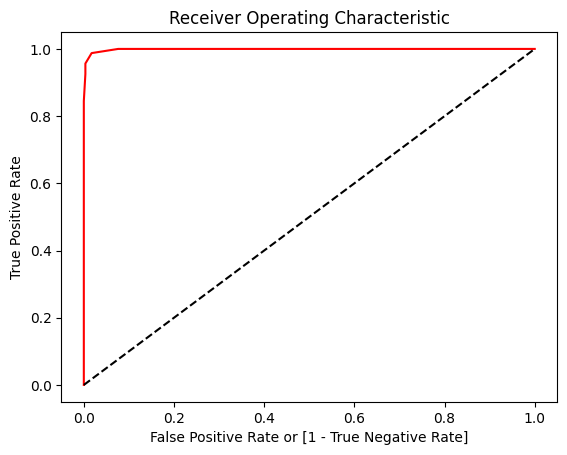

In [ ]:
fpr, tpr, thresholds = roc_curve(y_train, knn.predict_proba(X_train)[:,1])

auc = roc_auc_score(y_train, knn.predict(X_train))

plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, color='red', label='logit model ( area  = %0.2f)'%auc)
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate or [1 - True Negative Rate]')
plt.ylabel('True Positive Rate')

### Metrics for Testing Data (KNN)

In [ ]:
accuracy_score(y_test, knn.predict(X_test))

0.9380530973451328

In [ ]:
confusion_matrix(y_test, knn.predict(X_test))

array([[65,  2],
       [ 5, 41]])

In [ ]:
print(classification_report(y_test, knn.predict(X_test)))

              precision    recall  f1-score   support

         0.0       0.93      0.97      0.95        67
         1.0       0.95      0.89      0.92        46

    accuracy                           0.94       113
   macro avg       0.94      0.93      0.94       113
weighted avg       0.94      0.94      0.94       113



Text(0, 0.5, 'True Positive Rate')

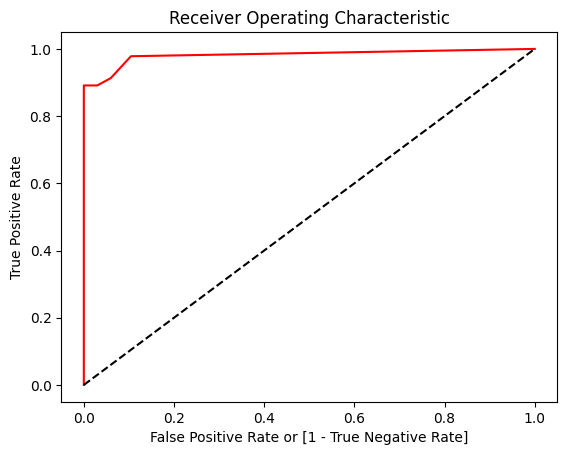

In [ ]:
fpr, tpr, thresholds = roc_curve(y_test, knn.predict_proba(X_test)[:,1])

auc = roc_auc_score(y_test, knn.predict(X_test))

plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, color='red', label='logit model ( area  = %0.2f)'%auc)
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate or [1 - True Negative Rate]')
plt.ylabel('True Positive Rate')

## Decision Tree

In [ ]:
DT = DecisionTreeClassifier()
DT.fit(X_train, y_train)

DecisionTreeClassifier()

In [ ]:
accuracy_score(y_train, DT.predict(X_train))

1.0

In [ ]:
confusion_matrix(y_train, DT.predict(X_train))

array([[289,   0],
       [  0, 161]])

In [ ]:
print(classification_report(y_train, DT.predict(X_train)))

              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00       289
         1.0       1.00      1.00      1.00       161

    accuracy                           1.00       450
   macro avg       1.00      1.00      1.00       450
weighted avg       1.00      1.00      1.00       450



Text(0, 0.5, 'True Positive Rate')

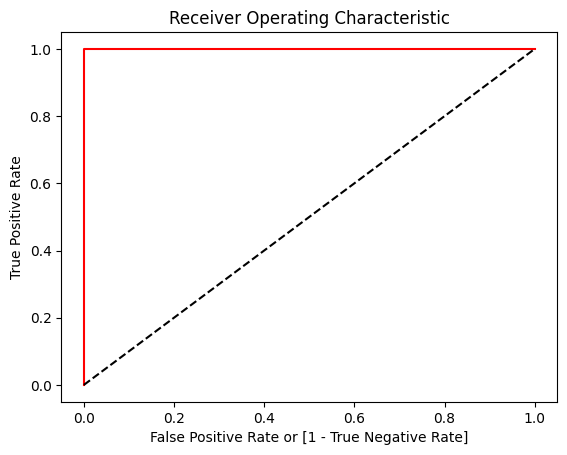

In [ ]:
fpr, tpr, thresholds = roc_curve(y_train, DT.predict_proba(X_train)[:,1])

auc = roc_auc_score(y_train, DT.predict(X_train))

plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, color='red', label='logit model ( area  = %0.2f)'%auc)
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate or [1 - True Negative Rate]')
plt.ylabel('True Positive Rate')

### Metrics for Test Data (Decision Tree)

In [ ]:
accuracy_score(y_test, DT.predict(X_test))

0.9292035398230089

In [ ]:
confusion_matrix(y_test, DT.predict(X_test))

array([[64,  3],
       [ 5, 41]])

In [ ]:
print(classification_report(y_test, DT.predict(X_test)))

              precision    recall  f1-score   support

         0.0       0.93      0.96      0.94        67
         1.0       0.93      0.89      0.91        46

    accuracy                           0.93       113
   macro avg       0.93      0.92      0.93       113
weighted avg       0.93      0.93      0.93       113



Text(0, 0.5, 'True Positive Rate')

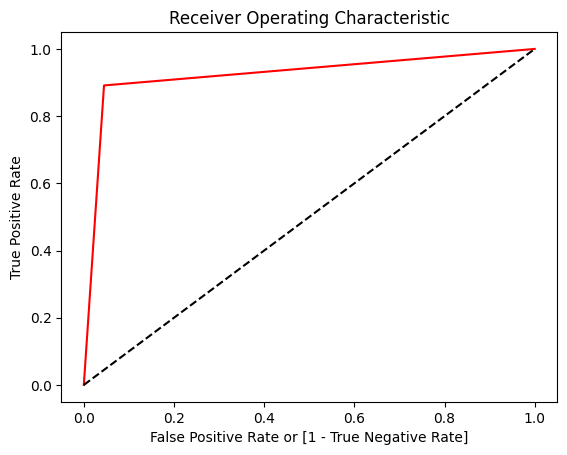

In [ ]:
fpr, tpr, thresholds = roc_curve(y_test, DT.predict_proba(X_test)[:,1])

auc = roc_auc_score(y_test, DT.predict(X_test))

plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, color='red', label='logit model ( area  = %0.2f)'%auc)
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate or [1 - True Negative Rate]')
plt.ylabel('True Positive Rate')

## Random Forest

In [ ]:
rf = RandomForestClassifier()
rf.fit(X_train, y_train)

RandomForestClassifier()

In [ ]:
accuracy_score(y_train, rf.predict(X_train))

1.0

In [ ]:
confusion_matrix(y_train, rf.predict(X_train))

array([[289,   0],
       [  0, 161]])

In [ ]:
print(classification_report(y_train, rf.predict(X_train)))

              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00       289
         1.0       1.00      1.00      1.00       161

    accuracy                           1.00       450
   macro avg       1.00      1.00      1.00       450
weighted avg       1.00      1.00      1.00       450



Text(0, 0.5, 'True Positive Rate')

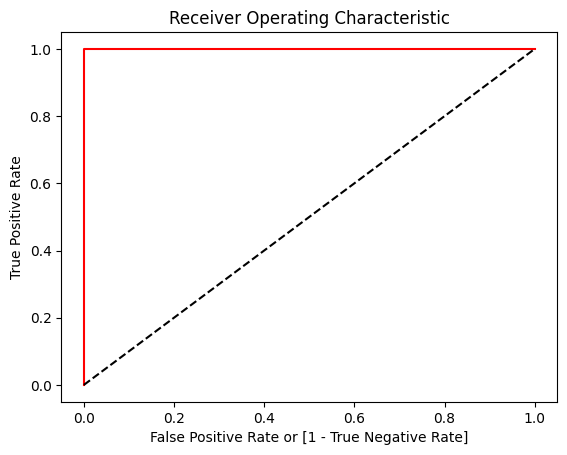

In [ ]:
fpr, tpr, thresholds = roc_curve(y_train, rf.predict_proba(X_train)[:,1])

auc = roc_auc_score(y_train, rf.predict(X_train))

plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, color='red', label='logit model ( area  = %0.2f)'%auc)
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate or [1 - True Negative Rate]')
plt.ylabel('True Positive Rate')

### Metrics for Test Data (Random Forest)

In [ ]:
accuracy_score(y_test, rf.predict(X_test))

0.9557522123893806

In [ ]:
confusion_matrix(y_test, rf.predict(X_test))

array([[66,  1],
       [ 4, 42]])

In [ ]:
print(classification_report(y_test, rf.predict(X_test)))

              precision    recall  f1-score   support

         0.0       0.94      0.99      0.96        67
         1.0       0.98      0.91      0.94        46

    accuracy                           0.96       113
   macro avg       0.96      0.95      0.95       113
weighted avg       0.96      0.96      0.96       113



Text(0, 0.5, 'True Positive Rate')

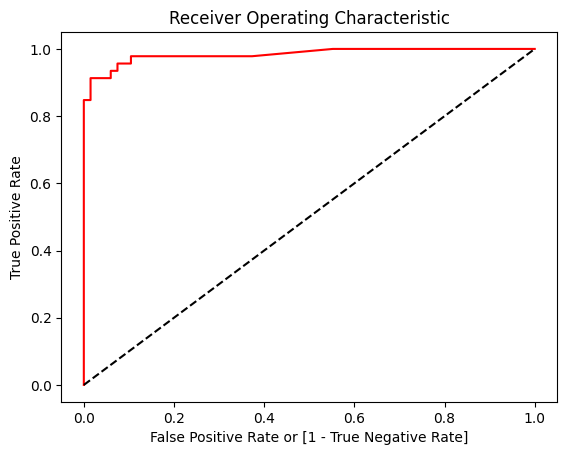

In [ ]:
fpr, tpr, thresholds = roc_curve(y_test, rf.predict_proba(X_test)[:,1])

auc = roc_auc_score(y_test, rf.predict(X_test))

plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, color='red', label='logit model ( area  = %0.2f)'%auc)
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate or [1 - True Negative Rate]')
plt.ylabel('True Positive Rate')

# Model Accuracy Table

In [ ]:
acc_table = pd.DataFrame({'Model': ['Logistic Regression',
                                    'Logistic Regression with Selected Features',
                                    'KNN',
                                    'Decision Tree',
                                    'Random Forest'],
                          'Training Accuracy': [accuracy_score(y_train, LogReg_model.predict(X_train)),
                                                accuracy_score(y_train, LogReg_model_2.predict(X_train[rfe_dict['Feature']])),
                                                accuracy_score(y_train, knn.predict(X_train)),
                                                accuracy_score(y_train, DT.predict(X_train)),
                                                accuracy_score(y_train, rf.predict(X_train))],
                          'Testing Accuracy': [accuracy_score(y_test, LogReg_model.predict(X_test)),
                                                accuracy_score(y_test, LogReg_model_2.predict(X_test[rfe_dict['Feature']])),
                                                accuracy_score(y_test, knn.predict(X_test)),
                                                accuracy_score(y_test, DT.predict(X_test)),
                                                accuracy_score(y_test, rf.predict(X_test))]})

In [ ]:
acc_table

,Model,Training Accuracy,Testing Accuracy
0,Logistic Regression,0.973333,0.938053
1,Logistic Regression with Selected Features,0.968889,0.946903
2,KNN,0.982222,0.938053
3,Decision Tree,1.000000,0.929204
4,Random Forest,1.000000,0.955752
